# Title: Object-based image analysis (OBIA) in GRASS GIS with a very high resolution satellite image. 

This workflow has been developed for the postgraduate course "Time Series Processing and Analysis with GRASS GIS".

Members of the group: Sol Villella and Tomás Valentín San Miguel.

# 1. Activation of GRASS and the working environment

## 1.1.  Preparing the working environment

In [1]:
# Check GRASS instalation path
!grass --config path

/usr/lib/grass83


In [2]:
# Import Python standard library and IPython packages we need.
import os
import subprocess
import sys

In [3]:
# Ask GRASS GIS where its Python packages are.
sys.path.append(
    subprocess.check_output(["grass", "--config", "python_path"], text=True).strip()
)

In [4]:
# Import the GRASS GIS packages we need.
import grass.script as gs
import grass.jupyter as gj

In [5]:
# Set data directory
homedir = "/home/GRASS"

# GRASS GIS database variables
grassdata = os.path.join(homedir, "grassdata")
gisdata = os.path.join(homedir, "gisdata")
project = "CBAposgar2007"
mapset = "PERMANENT"

os.chdir(homedir)

In [6]:
# Start the GRASS GIS Session
session = gj.init(grassdata, project, mapset)

In [7]:
# Check the CRS
print(gs.read_command("g.proj", flags="p"))

-PROJ_INFO-------------------------------------------------
name       : POSGAR 2007 / Argentina 4
ellps      : wgs84
proj       : tmerc
lat_0      : -90
lon_0      : -63
k          : 1
x_0        : 4500000
y_0        : 0
no_defs    : defined
-PROJ_SRID-------------------------------------------------
SRID       : EPSG:5346
-PROJ_UNITS------------------------------------------------
unit       : meter
units      : meters
meters     : 1



In [8]:
# Create a new mapset
gs.run_command("g.mapset",
               mapset="pleiades",
               flags="c")

In [9]:
# Check we are in the mapset just created
gs.run_command("g.mapset",
               flags="p")

pleiades


In [10]:
# List all the mapsets in the search path to check that we hace access to PERMANENT
gs.mapsets(search_path=True)

['pleiades', 'PERMANENT']

In [11]:
# R session 
# First we install the python package that allows us connect with R.
#!pip install rpy2==3.5.1
%reload_ext rpy2.ipython

In [ ]:
%%R
sessionInfo()

In [ ]:
#Installed from terminal
"""
%%R
install.packages("caret")
install.packages("kernlab")
install.packages("e1071")
install.packages("randomForest")
install.packages("rpart")
install.packages("ggplot")
install.packages("lattice")
install.packages("doParallel")
"""

## 1.2. Importing raster files

In [ ]:
pleiades_data = os.path.join(homedir, "gisdata", "pleiades_bands")
print(pleiades_data)

In [ ]:
# Import pleiades bands R, G, B, NIR
gs.run_command("r.import",
               input=os.path.join(pleiades_data, "IMG_PNEO3_20221028_BLUE_R3C1.TIF"),
               output="IMG_PNEO3_20221028_B",
               resolution="value",
               resolution_value=1.2)

gs.run_command("r.import",
               input=os.path.join(pleiades_data, "IMG_PNEO3_20221028_GREEN_R3C1.TIF"),
               output="IMG_PNEO3_20221028_G",
               resolution="value",
               resolution_value=1.2)

gs.run_command("r.import",
               input=os.path.join(pleiades_data, "IMG_PNEO3_20221028_RED_R3C1.TIF"),
               output="IMG_PNEO3_20221028_R",
               resolution="value",
               resolution_value=1.2)

gs.run_command("r.import",
               input=os.path.join(pleiades_data, "IMG_PNEO3_20221028_NIR_R3C1.TIF"),
               output="IMG_PNEO3_20221028_NIR",
               resolution="value",
               resolution_value=1.2)

In [14]:
# Import panchromatic band
gs.run_command("r.import",
               input=os.path.join(pleiades_data, "IMG_PNEO3_20221028_PAN2_R3C1.TIF"),
               output="IMG_PNEO3_20221028_P",
               resolution="value",
               resolution_value=0.3)

In [ ]:
# List imported raster maps
gs.list_grouped(type="raster")

In [ ]:
# Check metadata of some imported bands
gs.raster_info(map="IMG_PNEO3_20221028_P")

## 1.3. Definition of the computational region

In [12]:
# Set the computational region to the extent of a tile of Cordoba urban area, aligned with the panchromatic band
gs.run_command("g.region",
               flags="p",
               n=6521297.5423535,
               s=6518942.13801389,
               w=4389739.78983117,
               e=4392861.16565949,
               align="IMG_PNEO3_20221028_P",
               res=0.3
               )

projection: 99 (POSGAR 2007 / Argentina 4)
zone:       0
datum:      ** unknown (default: WGS84) **
ellipsoid:  wgs84
north:      6521297.7
south:      6518942.1
west:       4389739.5
east:       4392861.3
nsres:      0.3
ewres:      0.3
rows:       7852
cols:       10406
cells:      81707912


In [ ]:
!pip install folium #In case of local work

In [15]:
# Visualize results in an interactive map
b3_map=gj.InteractiveMap(width = 500, tiles="OpenStreetMap", use_region=True)
b3_map.add_raster("IMG_PNEO3_20221028_R")
#b3_map.add_raster("IMG_PNEO3_20221028_G")
#b3_map.add_raster("IMG_PNEO3_20221028_B")
b3_map.add_layer_control(position = "bottomright")
b3_map.show()

In [16]:
# Enhance the colors
gs.run_command("i.colors.enhance",
               red="IMG_PNEO3_20221028_R",
               green="IMG_PNEO3_20221028_G",
               blue="IMG_PNEO3_20221028_B",
               strength="95")

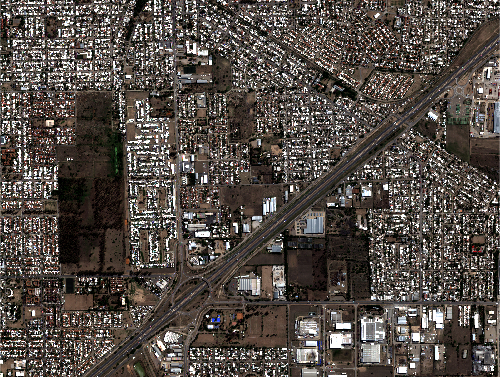

In [17]:
# Display RGB natural color using gj.Map
rgb_map = gj.Map(width=500, use_region=True)
rgb_map.d_rgb(red="IMG_PNEO3_20221028_R",
              green="IMG_PNEO3_20221028_G",
              blue="IMG_PNEO3_20221028_B",)
rgb_map.show()

# 2. Pansharpening

We will use the panchromatic band (0.3 m) to improve the definition of the 1.2 m spectral bands.

In [25]:
# Install the reqquired addon
gs.run_command("g.extension",
               extension="i.fusion.hpf")

Tu rama está actualizada con 'origin/grass8'.


In [19]:
# Set the region to PAN band (0.3m)
gs.run_command("g.region",
               n=6521297.5423535,
               s=6518942.13801389,
               w=4389739.78983117,
               e=4392861.16565949,
               align="IMG_PNEO3_20221028_P",
               res=0.3,
               flags="p")

projection: 99 (POSGAR 2007 / Argentina 4)
zone:       0
datum:      ** unknown (default: WGS84) **
ellipsoid:  wgs84
north:      6521297.7
south:      6518942.1
west:       4389739.5
east:       4392861.3
nsres:      0.3
ewres:      0.3
rows:       7852
cols:       10406
cells:      81707912


In [20]:
from re import Pattern
# List bands
ms_bands = gs.list_grouped(type="raster", exclude="IMG_PNEO3_20221028_P")['pleiades']
ms_bands

['IMG_PNEO3_20221028_B',
 'IMG_PNEO3_20221028_G',
 'IMG_PNEO3_20221028_NIR',
 'IMG_PNEO3_20221028_R']

In [ ]:
# Apply the fusion based on high pass filter
gs.run_command("i.fusion.hpf",
               pan="IMG_PNEO3_20221028_P", 
               msx=ms_bands,
               suffix="hpf", 
               center="high", 
               modulation="max", 
               trim="0.0", 
               flags="lc")

In [13]:
# List the fused maps
gs.list_grouped(type="raster",
                pattern="*.hpf")["pleiades"]

['IMG_PNEO3_20221028_B.hpf',
 'IMG_PNEO3_20221028_G.hpf',
 'IMG_PNEO3_20221028_NIR.hpf',
 'IMG_PNEO3_20221028_R.hpf']

In [ ]:
# Display original and fused maps
hpf_map = gj.InteractiveMap(width = 50, tiles="OpenStreetMap")
hpf_map.add_raster("IMG_PNEO3_20221028_G.hpf")
hpf_map.add_raster("IMG_PNEO3_20221028_G")
hpf_map.add_layer_control(position = "bottomright")
hpf_map.show()

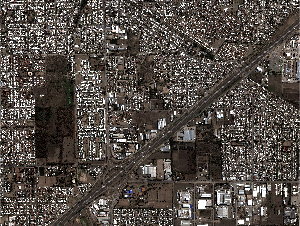

In [17]:
# Display RGB fused maps
rgb_map = gj.Map(width=300, use_region=True)
rgb_map.d_rgb(red="IMG_PNEO3_20221028_R.hpf",
              green="IMG_PNEO3_20221028_G.hpf",
              blue="IMG_PNEO3_20221028_B.hpf",)
rgb_map.show()

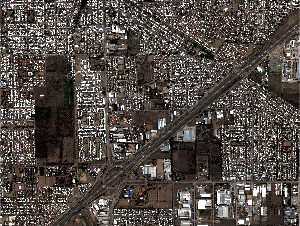

In [18]:
# Display RGB original bands
rgb_map = gj.Map(width=300, use_region=True)
rgb_map.d_rgb(red="IMG_PNEO3_20221028_R",
              green="IMG_PNEO3_20221028_G",
              blue="IMG_PNEO3_20221028_B")
rgb_map.show()

# 3. Rescaling of reflectance values to remove null cells

Pleiades neo images with reflectance level processing, such as the one used in this work, have a scale of values from 0 to 10000. However, it is possible to find values above 10000. On the other hand, for a later calculation of the NDVI and NDWI indices, the cells containing 0 in both bands involved in the calculation of the index are given a zero value by trying to divide by zeros. To avoid future errors, we limit the values between 1 and 10000.

In [45]:
#R band: rescale >10000 to 10000
gs.mapcalc(exp="PNEO3_20221028_R_res=if(IMG_PNEO3_20221028_R.hpf>=10000,10000,IMG_PNEO3_20221028_R.hpf)")

#R band: rescale =0 to 1
gs.mapcalc(exp="PNEO3_20221028_R_res2=if(PNEO3_20221028_R_res==0,1,PNEO3_20221028_R_res)")

In [46]:
# Check null cells
print(gs.read_command("r.univar",
                      map="PNEO3_20221028_R_res2"))

total null and non-null cells: 81707912
total null cells: 0

Of the non-null cells:
----------------------
n: 81707912
minimum: 1
maximum: 10000
range: 9999
mean: 1766.35
mean of absolute values: 1766.35
standard deviation: 1226.31
variance: 1.50384e+06
variation coefficient: 69.4262 %
sum: 144324996275



In [47]:
#G band: rescale >10000 to 10000
gs.mapcalc(exp="PNEO3_20221028_G_res=if(IMG_PNEO3_20221028_G.hpf>=10000,10000,IMG_PNEO3_20221028_G.hpf)")

#G band: rescale =0 to 1
gs.mapcalc(exp="PNEO3_20221028_G_res2=if(PNEO3_20221028_G_res==0,1,PNEO3_20221028_G_res)")

In [48]:
# Check null cells
print(gs.read_command("r.univar",
                      map="PNEO3_20221028_G_res2"))

total null and non-null cells: 81707912
total null cells: 0

Of the non-null cells:
----------------------
n: 81707912
minimum: 1
maximum: 10000
range: 9999
mean: 1553.16
mean of absolute values: 1553.16
standard deviation: 1112.53
variance: 1.23773e+06
variation coefficient: 71.6304 %
sum: 126905278917



In [51]:
#B band: rescale >10000 to 10000
gs.mapcalc(exp="PNEO3_20221028_B_res=if(IMG_PNEO3_20221028_B.hpf>=10000,10000,IMG_PNEO3_20221028_B.hpf)")

#B band: rescale =0 to 1
gs.mapcalc(exp="PNEO3_20221028_B_res2=if(PNEO3_20221028_B_res==0,1,PNEO3_20221028_B_res)")

In [52]:
# Check null cells
print(gs.read_command("r.univar",
                      map="PNEO3_20221028_B_res2"))

total null and non-null cells: 81707912
total null cells: 0

Of the non-null cells:
----------------------
n: 81707912
minimum: 1
maximum: 10000
range: 9999
mean: 1328.7
mean of absolute values: 1328.7
standard deviation: 1013.36
variance: 1.02691e+06
variation coefficient: 76.2672 %
sum: 108565509950



In [53]:
#NIR band: rescale >10000 to 10000
gs.mapcalc(exp="PNEO3_20221028_NIR_res=if(IMG_PNEO3_20221028_NIR.hpf>=10000,10000,IMG_PNEO3_20221028_NIR.hpf)")

#NIR band: rescale =0 to 1
gs.mapcalc(exp="PNEO3_20221028_NIR_res2=if(PNEO3_20221028_NIR_res==0,1,PNEO3_20221028_NIR_res)")

In [54]:
# Check null cells
print(gs.read_command("r.univar",
                      map="PNEO3_20221028_NIR_res2"))

total null and non-null cells: 81707912
total null cells: 0

Of the non-null cells:
----------------------
n: 81707912
minimum: 1
maximum: 10000
range: 9999
mean: 2658.49
mean of absolute values: 2658.49
standard deviation: 1156.72
variance: 1.33801e+06
variation coefficient: 43.5105 %
sum: 217219860545



In [13]:
#PAN band: rescale >10000 to 10000
gs.mapcalc(exp="PNEO3_20221028_P_res=if(IMG_PNEO3_20221028_P_cut>=10000,10000,IMG_PNEO3_20221028_P_cut)")

#PAN band: rescale =0 to 1
gs.mapcalc(exp="PNEO3_20221028_P_res2=if(PNEO3_20221028_P_res==0,1,PNEO3_20221028_P_res)")

In [14]:
# Check null cells
print(gs.read_command("r.univar",
                      map="PNEO3_20221028_P_res"))

total null and non-null cells: 81707912
total null cells: 0

Of the non-null cells:
----------------------
n: 81707912
minimum: 1
maximum: 10000
range: 9999
mean: 1807.58
mean of absolute values: 1807.58
standard deviation: 1222.02
variance: 1.49333e+06
variation coefficient: 67.6054 %
sum: 147693210720



# 4. Implementation of Object Based Image Analysis (OBIA) 

## 4.1. Spectral indexes and GLCM textures

Water indices (NDWI), vegetation indices (NDVI) and two texture indices (ASM and IDM) are estimated.

In [62]:
# Estimate vegetation index
gs.run_command("i.vi", 
               red="PNEO3_20221028_R_res2", 
               nir="PNEO3_20221028_NIR_res2", 
               output="PNEO3_20221028_NDVI_res", 
               viname="ndvi")

In [63]:
# Check null cells
print(gs.read_command("r.univar",
                      map="PNEO3_20221028_NDVI_res"))

total null and non-null cells: 81707912
total null cells: 0

Of the non-null cells:
----------------------
n: 81707912
minimum: -0.996241
maximum: 0.999496
range: 1.99574
mean: 0.241728
mean of absolute values: 0.241743
standard deviation: 0.144592
variance: 0.0209068
variation coefficient: 59.816 %
sum: 19751070.5187862



In [64]:
# Install i.wi
#gs.run_command("g.extension", 
               #extension="i.wi")
               
# Estimate water index
gs.run_command("i.wi", 
               green="PNEO3_20221028_G_res2", 
               nir="PNEO3_20221028_NIR_res2", 
               output="PNEO3_20221028_NDWI_res", 
               winame="ndwi_mf")

# Set ndwi color palette
gs.run_command("r.colors", 
               map="PNEO3_20221028_NDWI_res", 
               color="ndwi")

In [65]:
# Check null cells
print(gs.read_command("r.univar",
                      map="PNEO3_20221028_NDWI_res"))

total null and non-null cells: 81707912
total null cells: 0

Of the non-null cells:
----------------------
n: 81707912
minimum: -0.999626
maximum: 0.992126
range: 1.99175
mean: -0.299564
mean of absolute values: 0.299595
standard deviation: 0.128852
variance: 0.0166028
variation coefficient: -43.0132 %
sum: -24476766.2708071



In [15]:
# Estimate textures measures
gs.run_command("r.texture",
               input="PNEO3_20221028_P_res2",
               output="PNEO3_20221028_text",
               size=7,
               distance=3,
               method="idm,asm")

In [16]:
# Set color table to grey for texture bands
gs.run_command("r.colors", 
               map="PNEO3_20221028_text_IDM", 
               color="grey",
               flags="e")
gs.run_command("r.colors", 
               map="PNEO3_20221028_text_ASM", 
               color="grey",
               flags="e")

In [11]:
# From now on we will work with a slightly smaller region to avoid 
# including zero values that have formed at the edges of the texture images.
gs.run_command("g.region",
               flags="p",
               n=6521296.4944824883714318,
               s=6518943.2901352876797318,
               w=4389740.6960059516131878,
               e=4392860.1079660020768642,
               align="PNEO3_20221028_P_res2",
               res=0.3
               )
gs.run_command("g.region",
               save="obia_subset")

projection: 99 (POSGAR 2007 / Argentina 4)
zone:       0
datum:      ** unknown (default: WGS84) **
ellipsoid:  wgs84
north:      6521296.5
south:      6518943
west:       4389740.4
east:       4392860.4
nsres:      0.3
ewres:      0.3
rows:       7845
cols:       10400
cells:      81588000


In [19]:
# Check null cells for one of the texture band
print(gs.read_command("r.univar",
                      map="PNEO3_20221028_text_IDM"))

total null and non-null cells: 81588000
total null cells: 0

Of the non-null cells:
----------------------
n: 81588000
minimum: 0.000371511
maximum: 1
range: 0.999628
mean: 0.235957
mean of absolute values: 0.235957
standard deviation: 0.170583
variance: 0.0290984
variation coefficient: 72.294 %
sum: 19251239.9653698



In [ ]:
#Display the new bands
idx_map = gj.InteractiveMap(width = 400, use_region=False, tiles="OpenStreetMap")
idx_map.add_raster("PNEO3_20221028_NDVI", opacity=0.7)
idx_map.add_raster("PNEO3_20221028_NDWI", opacity=0.7)
idx_map.add_raster("PNEO3_20221028_text_IDM", opacity=0.7)
idx_map.add_raster("PNEO3_20221028_text_ASM", opacity=0.7)
idx_map.add_layer_control(position = "bottomright")
idx_map.show()

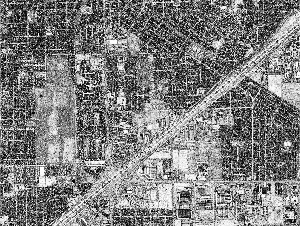

In [23]:
#Display the new bands
cba_rgb = gj.Map(width=300,use_region=False)
cba_rgb.d_rast(map="PNEO3_20221028_text_ASM")
cba_rgb.show()

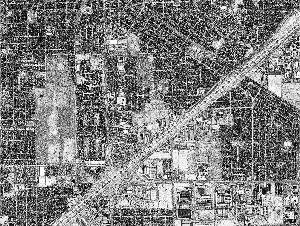

In [24]:
cba_rgb = gj.Map(width=300, use_region=False)
cba_rgb.d_rast(map="PNEO3_20221028_text_IDM")
cba_rgb.show()

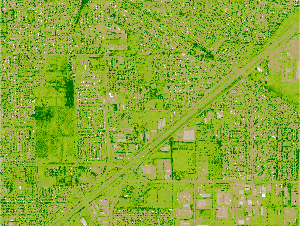

In [25]:
cba_rgb = gj.Map(width=300, use_region=False)
cba_rgb.d_rast(map="PNEO3_20221028_NDVI_res")
cba_rgb.show()

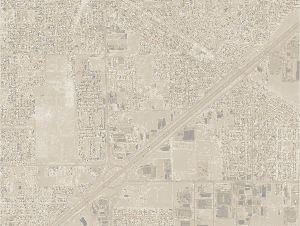

In [26]:
cba_rgb = gj.Map(width=300, use_region=False)
cba_rgb.d_rast(map="PNEO3_20221028_NDWI_res")
cba_rgb.show()

## 4.2. Segmentation

First we generate tiles with i.cutlines, then we create superpixels and finally we perform the segmentation.

In [20]:
# Separate only the pansharpened bands
pansharp = gs.list_grouped(type="raster", pattern="*res2", exclude="PNEO3_20221028_P_res2")["pleiades"]
pansharp

['PNEO3_20221028_B_res2',
 'PNEO3_20221028_G_res2',
 'PNEO3_20221028_NIR_res2',
 'PNEO3_20221028_R_res2']

In [14]:
# Create imagery group only with the panshapened multispectral bands
gs.run_command("i.group",
               group="pleiades_msbands",
               input=pansharp)

In [22]:
# Install extension
gs.run_command("g.extension",
               extension="i.superpixels.slic")

Tu rama está actualizada con 'origin/grass8'.


In [26]:
# Install extensions
gs.run_command("g.extension", 
               extension="r.neighborhoodmatrix")
gs.run_command("g.extension", 
               extension="i.segment.uspo")

Tu rama está actualizada con 'origin/grass8'.
Tu rama está actualizada con 'origin/grass8'.


### 4.2.1. Generate tiles with i.cutlines

In [ ]:
#Install extension
gs.run_command("g.extension",
               extension="i.cutlines")

In [ ]:
#Install extension
gs.run_command("g.extension",
               extension="i.edge")

In [ ]:
gs.run_command("i.cutlines",
               input="PNEO3_20221028_P_res2",
               output="cutlines",
               number_lines=10,
               tile_width=3000,
               tile_height=3000,
               overlap=1,
               min_tile_size=70000,
               no_edge_friction=20,
               lane_border_multiplier=500,
               processes=6,
               memory=8000,
               edge_detection="canny")

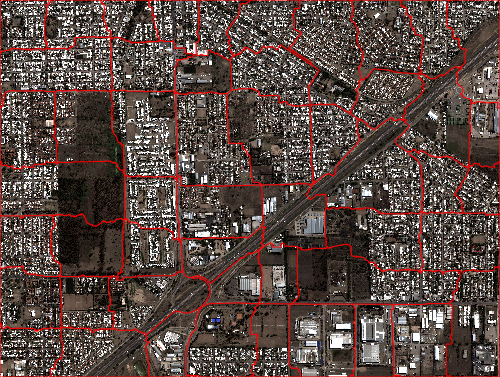

In [32]:
segs = gj.Map(width=500, use_region=True)
segs.d_rgb(red="IMG_PNEO3_20221028_R.hpf",
              green="IMG_PNEO3_20221028_G.hpf",
              blue="IMG_PNEO3_20221028_B.hpf")
segs.d_vect(map="region_uspo", type="boundary", color="red")
segs.show()

In [33]:
gs.vector_db_select("region_uspo")["columns"]

['cat', 'cat_']

In [25]:
# Convert labeled test segments to raster and recategorize
gs.run_command("v.to.rast",
               input="cutlines",
               use="cat",
               output="cutlines_canny")

In [26]:
gs.run_command("r.clump",
               input="cutlines_canny",
               output="cutlines_clumped",
               overwrite=True)

In [10]:
cats=gs.parse_command("r.category", map="cutlines_clumped")

In [83]:
type(cats.keys())

dict_keys

In [11]:
for cat in cats.keys():
    print(cat)

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51


### 4.2.2. Create superpixels and segment each tile

In [12]:
for cat in cats:
    gs.run_command("r.mask", raster="cutlines_clumped", maskcats=f"{cat}")
    gs.run_command("g.region", zoom="MASK", raster="PNEO3_20221028_P_res2", save="temp_region")
  

    # i.superpixels slic
    gs.run_command("i.superpixels.slic",
                   input="pleiades_msbands", 
                   step=3,
                   compactness=0.7,
                   output=f"slic_map_{cat}",
                   perturb=5,
                   memory=8000,
                   overwrite=True)
    
    # i.segment.uspo
    gs.run_command("i.segment.uspo",
                   group="pleiades_msbands",
                   output=f"uspo_parameters_cat{cat}.csv",
                   region="temp_region",
                   seeds=f"slic_map_{cat}",
                   segment_map=f"segs_uspo_cat{cat}",
                   threshold_start=0.005,
                   threshold_stop=0.05,
                   threshold_step=0.01,  #el original era 0,005
                   minsizes=8, 
                   memory=8000,
                   processes=6,
                   overwrite=True)
    
    # Convert to vector the rank1 (best result)
    gs.run_command("r.to.vect",
                   input=f"segs_uspo_cat{cat}_temp_region_rank1",
                   output=f"segs_uspo_cat{cat}_temp_region_rank1",
                   type="area",
                   flags="tv",
                   overwrite=True)
   
   # Delete slic_maps
    gs.run_command("g.remove", flags="f", type="raster", name=f"slic_map_{cat}")


In [63]:
!v.info segs_uspo_cat1_temp_region_rank1

 +----------------------------------------------------------------------------+
 | Nombre:          segs_uspo_cat1_temp_region_rank1                          |
 | Directorio de mapas:pleiades                                               |
 | Localización:    CBAposgar2007                                             |
 | Base de datos:   /media/sol/archivos2/Documentos/GRASS/grassdata           |
 | Título:                                                                    |
 | Escala de mapa:  1:1                                                       |
 | Nombre del creador:sol                                                     |
 | Organización:                                                              |
 | Fecha del origen:Tue Oct 10 11:21:27 2023                                  |
 | Marca de tiempo (primer capa): nada                                        |
 |----------------------------------------------------------------------------|
 | Formato del mapa:native              

In [13]:
!r.mask -r

Ráster MASCARA removido


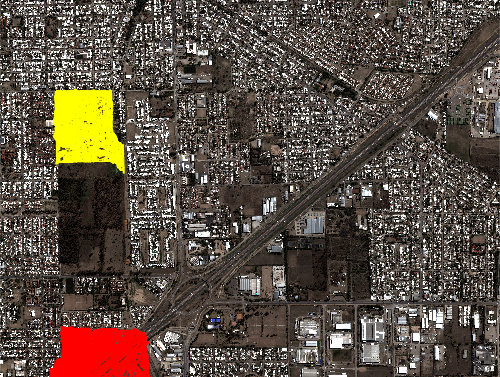

In [15]:
#Examples of segmentation generated for different tiles
segs = gj.Map(width=500, use_region="obia_subset")
segs.d_rgb(red="IMG_PNEO3_20221028_R.hpf",
              green="IMG_PNEO3_20221028_G.hpf",
              blue="IMG_PNEO3_20221028_B.hpf")
segs.d_vect(map="segs_uspo_cat45_temp_region_rank1", type="boundary", color="red")
segs.d_vect(map="segs_uspo_cat20_temp_region_rank1", type="boundary", color="yellow")
segs.show()

In [17]:
# Set original region
!g.region region="obia_subset"

In [53]:
# patch tiles together and clump
list_tiles=gs.parse_command("g.list",type="raster",pattern="segs_uspo_cat*", separator="comma")

In [54]:
for cat in list_tiles.keys():
    print(cat)

segs_uspo_cat10_temp_region_rank1,segs_uspo_cat11_temp_region_rank1,segs_uspo_cat12_temp_region_rank1,segs_uspo_cat13_temp_region_rank1,segs_uspo_cat14_temp_region_rank1,segs_uspo_cat15_temp_region_rank1,segs_uspo_cat16_temp_region_rank1,segs_uspo_cat17_temp_region_rank1,segs_uspo_cat18_temp_region_rank1,segs_uspo_cat19_temp_region_rank1,segs_uspo_cat1_temp_region_rank1,segs_uspo_cat20_temp_region_rank1,segs_uspo_cat21_temp_region_rank1,segs_uspo_cat22_temp_region_rank1,segs_uspo_cat23_temp_region_rank1,segs_uspo_cat24_temp_region_rank1,segs_uspo_cat25_temp_region_rank1,segs_uspo_cat26_temp_region_rank1,segs_uspo_cat27_temp_region_rank1,segs_uspo_cat28_temp_region_rank1,segs_uspo_cat29_temp_region_rank1,segs_uspo_cat2_temp_region_rank1,segs_uspo_cat30_temp_region_rank1,segs_uspo_cat31_temp_region_rank1,segs_uspo_cat32_temp_region_rank1,segs_uspo_cat33_temp_region_rank1,segs_uspo_cat34_temp_region_rank1,segs_uspo_cat35_temp_region_rank1,segs_uspo_cat36_temp_region_rank1,segs_uspo_cat37_

In [57]:
list_tiles="segs_uspo_cat10_temp_region_rank1,segs_uspo_cat11_temp_region_rank1,segs_uspo_cat12_temp_region_rank1,segs_uspo_cat13_temp_region_rank1,segs_uspo_cat14_temp_region_rank1,segs_uspo_cat15_temp_region_rank1,segs_uspo_cat16_temp_region_rank1,segs_uspo_cat17_temp_region_rank1,segs_uspo_cat18_temp_region_rank1,segs_uspo_cat19_temp_region_rank1,segs_uspo_cat1_temp_region_rank1,segs_uspo_cat20_temp_region_rank1,segs_uspo_cat21_temp_region_rank1,segs_uspo_cat22_temp_region_rank1,segs_uspo_cat23_temp_region_rank1,segs_uspo_cat24_temp_region_rank1,segs_uspo_cat25_temp_region_rank1,segs_uspo_cat26_temp_region_rank1,segs_uspo_cat27_temp_region_rank1,segs_uspo_cat28_temp_region_rank1,segs_uspo_cat29_temp_region_rank1,segs_uspo_cat2_temp_region_rank1,segs_uspo_cat30_temp_region_rank1,segs_uspo_cat31_temp_region_rank1,segs_uspo_cat32_temp_region_rank1,segs_uspo_cat33_temp_region_rank1,segs_uspo_cat34_temp_region_rank1,segs_uspo_cat35_temp_region_rank1,segs_uspo_cat36_temp_region_rank1,segs_uspo_cat37_temp_region_rank1,segs_uspo_cat38_temp_region_rank1,segs_uspo_cat39_temp_region_rank1,segs_uspo_cat3_temp_region_rank1,segs_uspo_cat40_temp_region_rank1,segs_uspo_cat41_temp_region_rank1,segs_uspo_cat42_temp_region_rank1,segs_uspo_cat43_temp_region_rank1,segs_uspo_cat44_temp_region_rank1,segs_uspo_cat45_temp_region_rank1,segs_uspo_cat46_temp_region_rank1,segs_uspo_cat47_temp_region_rank1,segs_uspo_cat48_temp_region_rank1,segs_uspo_cat49_temp_region_rank1,segs_uspo_cat4_temp_region_rank1,segs_uspo_cat50_temp_region_rank1,segs_uspo_cat51_temp_region_rank1,segs_uspo_cat5_temp_region_rank1,segs_uspo_cat6_temp_region_rank1,segs_uspo_cat7_temp_region_rank1,segs_uspo_cat8_temp_region_rank1,segs_uspo_cat9_temp_region_rank1"


In [60]:
gs.run_command("r.patch",
               input=list_tiles, 
               output="patched_segmented_tiles",
               nprocs=6,
               memory=8000)

In [61]:
# Generate a single raster with segments by unifying their values.
gs.run_command("r.clump",input="patched_segmented_tiles",output="segments_full_region",overwrite=True)

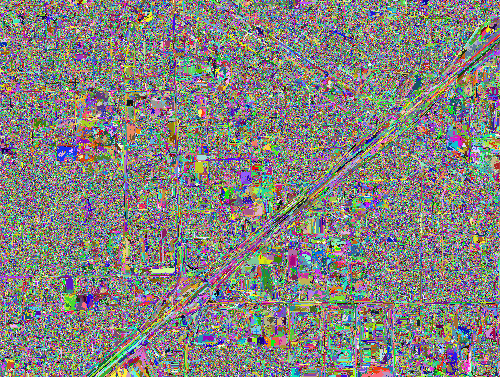

In [67]:
# Plot the segments of the full region
cba_rgb = gj.Map(width=500,use_region=False)
cba_rgb.d_rast(map="segments_full_region")
cba_rgb.show()

In [62]:
# Convertir raster en vector
gs.run_command("r.to.vect",input="segments_full_region",output="segments_full_region",type="area",overwrite=True)

In [65]:
!v.info map=segments_full_region

 +----------------------------------------------------------------------------+
 | Nombre:          segments_full_region                                      |
 | Directorio de mapas:pleiades                                               |
 | Localización:    CBAposgar2007                                             |
 | Base de datos:   /media/sol/archivos2/Documentos/GRASS/grassdata           |
 | Título:                                                                    |
 | Escala de mapa:  1:1                                                       |
 | Nombre del creador:sol                                                     |
 | Organización:                                                              |
 | Fecha del origen:Tue Oct 10 14:32:13 2023                                  |
 | Marca de tiempo (primer capa): nada                                        |
 |----------------------------------------------------------------------------|
 | Formato del mapa:native              

### 4.2.2. Segment statistics

In [13]:
#Install extension
gs.run_command("g.extension", 
               extension="i.segment.stats")

Tu rama está actualizada con 'origin/grass8'.


In [66]:
# Extract stats for training segments
gs.run_command("i.segment.stats",
               map="segments_full_region",
               rasters="PNEO3_20221028_text_ASM,PNEO3_20221028_text_IDM,PNEO3_20221028_NDVI_res,PNEO3_20221028_NDWI_res,PNEO3_20221028_P_res2",
               raster_statistics="mean,stddev",
               area_measures="area,perimeter,compact_circle,compact_square",
               vectormap="vector_map_segs_stats", #nosotros generamos este en vez del csv
               processes=6)

## 4.3. Classification with Machine Learning

### 4.3.1. Import ground truth point data

In [13]:
# Import labeled points vector layer
gs.run_command("v.import",
               input=os.path.join(gisdata,"puntos_clases_tp.gpkg"),
               output="labeled_points")

In [14]:
# Get info of labeled points
gs.vector_info_topo("labeled_points")

{'nodes': 0,
 'points': 260,
 'lines': 0,
 'boundaries': 0,
 'centroids': 0,
 'areas': 0,
 'islands': 0,
 'primitives': 260,
 'map3d': False}

In [15]:
# Get number of points per class
print(gs.read_command("db.select",
                      sql="SELECT train_class,COUNT(cat) as count_class FROM labeled_points GROUP BY train_class"))

train_class|count_class
1|40
2|54
3|11
4|84
5|30
6|29
7|12



In [68]:
# Select segments that are below labeled points
gs.run_command("v.select",
               ainput="vector_map_segs_stats", # vector obtenido con i.segment.stats
               binput="labeled_points",
               output="train_segments",
               operator="overlap")

In [69]:
# Get info of segments
gs.vector_info_topo(map="train_segments")

{'nodes': 8625,
 'points': 0,
 'lines': 0,
 'boundaries': 8702,
 'centroids': 258,
 'areas': 740,
 'islands': 663,
 'primitives': 8960,
 'map3d': False}

In [71]:
# Add column to train segments
gs.run_command("v.db.addcolumn",
               map="train_segments",
               column="class int")

In [73]:
# Assign label from points to segments
gs.run_command("v.distance",
               from_="train_segments", 
               to="labeled_points",
               upload="to_attr",
               column="class",
               to_column="train_class")

In [74]:
# Group training segments per class
!db.select sql="SELECT class,COUNT(cat) as count_class FROM train_segments GROUP BY class"

class|count_class
1|40
2|52
3|11
4|84
5|30
6|29
7|12


In [75]:
print(gs.read_command("db.describe",
                      table="train_segments",
                      flags="c"))

ncols: 16
nrows: 258
Column 1: cat:INTEGER:20
Column 2: area:DOUBLE PRECISION:20
Column 3: perimeter:DOUBLE PRECISION:20
Column 4: compact_circle:DOUBLE PRECISION:20
Column 5: compact_square:DOUBLE PRECISION:20
Column 6: PNEO3_20221028_text_ASM_mean:DOUBLE PRECISION:20
Column 7: PNEO3_20221028_text_ASM_stddev:DOUBLE PRECISION:20
Column 8: PNEO3_20221028_text_IDM_mean:DOUBLE PRECISION:20
Column 9: PNEO3_20221028_text_IDM_stddev:DOUBLE PRECISION:20
Column 10: PNEO3_20221028_NDVI_res_mean:DOUBLE PRECISION:20
Column 11: PNEO3_20221028_NDVI_res_stddev:DOUBLE PRECISION:20
Column 12: PNEO3_20221028_NDWI_res_mean:DOUBLE PRECISION:20
Column 13: PNEO3_20221028_NDWI_res_stddev:DOUBLE PRECISION:20
Column 14: PNEO3_20221028_P_res2_mean:DOUBLE PRECISION:20
Column 15: PNEO3_20221028_P_res2_stddev:DOUBLE PRECISION:20
Column 16: class:INTEGER:20



### 4.3.2. Separation of dataset into training and test

In [ ]:
# Install the extension
gs.run_command("g.extension",
               extension="v.divide.training_validation",
               url="https://github.com/mundialis/v.divide.training_validation")

In [76]:
# Divide our labeled segments into train and test
gs.run_command("v.divide.training_validation",
               input="train_segments", # vector de seg de entr con clases
               column="class", 
               training="training", 
               validation="testing", 
               training_percent=70)

In [77]:
# Group training segments per class
!db.select sql="SELECT class,COUNT(cat) as count_class FROM training GROUP BY class"

class|count_class
1|28
2|36
3|8
4|59
5|21
6|20
7|8


In [78]:
# Group testing segments per class
!db.select sql="SELECT class,COUNT(cat) as count_class FROM testing GROUP BY class"

class|count_class
1|12
2|16
3|3
4|25
5|9
6|9
7|4


In [79]:
print(gs.read_command("db.describe",
                      table="training",
                      flags="c"))

ncols: 16
nrows: 180
Column 1: cat:INTEGER:20
Column 2: area:DOUBLE PRECISION:20
Column 3: perimeter:DOUBLE PRECISION:20
Column 4: compact_circle:DOUBLE PRECISION:20
Column 5: compact_square:DOUBLE PRECISION:20
Column 6: PNEO3_20221028_text_ASM_mean:DOUBLE PRECISION:20
Column 7: PNEO3_20221028_text_ASM_stddev:DOUBLE PRECISION:20
Column 8: PNEO3_20221028_text_IDM_mean:DOUBLE PRECISION:20
Column 9: PNEO3_20221028_text_IDM_stddev:DOUBLE PRECISION:20
Column 10: PNEO3_20221028_NDVI_res_mean:DOUBLE PRECISION:20
Column 11: PNEO3_20221028_NDVI_res_stddev:DOUBLE PRECISION:20
Column 12: PNEO3_20221028_NDWI_res_mean:DOUBLE PRECISION:20
Column 13: PNEO3_20221028_NDWI_res_stddev:DOUBLE PRECISION:20
Column 14: PNEO3_20221028_P_res2_mean:DOUBLE PRECISION:20
Column 15: PNEO3_20221028_P_res2_stddev:DOUBLE PRECISION:20
Column 16: class:INTEGER:20



In [80]:
print(gs.read_command("db.describe",
                      table="testing",
                      flags="c"))

ncols: 16
nrows: 78
Column 1: cat:INTEGER:20
Column 2: area:DOUBLE PRECISION:20
Column 3: perimeter:DOUBLE PRECISION:20
Column 4: compact_circle:DOUBLE PRECISION:20
Column 5: compact_square:DOUBLE PRECISION:20
Column 6: PNEO3_20221028_text_ASM_mean:DOUBLE PRECISION:20
Column 7: PNEO3_20221028_text_ASM_stddev:DOUBLE PRECISION:20
Column 8: PNEO3_20221028_text_IDM_mean:DOUBLE PRECISION:20
Column 9: PNEO3_20221028_text_IDM_stddev:DOUBLE PRECISION:20
Column 10: PNEO3_20221028_NDVI_res_mean:DOUBLE PRECISION:20
Column 11: PNEO3_20221028_NDVI_res_stddev:DOUBLE PRECISION:20
Column 12: PNEO3_20221028_NDWI_res_mean:DOUBLE PRECISION:20
Column 13: PNEO3_20221028_NDWI_res_stddev:DOUBLE PRECISION:20
Column 14: PNEO3_20221028_P_res2_mean:DOUBLE PRECISION:20
Column 15: PNEO3_20221028_P_res2_stddev:DOUBLE PRECISION:20
Column 16: class:INTEGER:20



### 4.3.3. Model training and classification with the training dataset (70%)

In [81]:
# Run classification
gs.run_command("v.class.mlR",
               segments_map="vector_map_segs_stats", # vector with all segments
               training_map="training", # vector with training segs
               train_class_column="class",
               classified_map="classification",
               raster_segments_map="segments_full_region",
               classifier="rf",
               folds=5,
               partitions=10,
               tunelength=10,
               weighting_modes="smv",
               weighting_metric="accuracy",
               output_model_file="model",
               variable_importance_file="var_imp.txt",
               accuracy_file="accuracy.csv",
               model_details="classifier_runs.txt",
               r_script_file="Rscript_mlR.R",
               processes=6, # use more if available
               flags="n")

Loading required package: ggplot2
Loading required package: lattice
Loading required package: foreach
Loading required package: iterators
Loading required package: parallel


In [82]:
# Set color table that we created interactively
gs.run_command("r.colors",
               map="classification_rf",
               rules="blablabla")

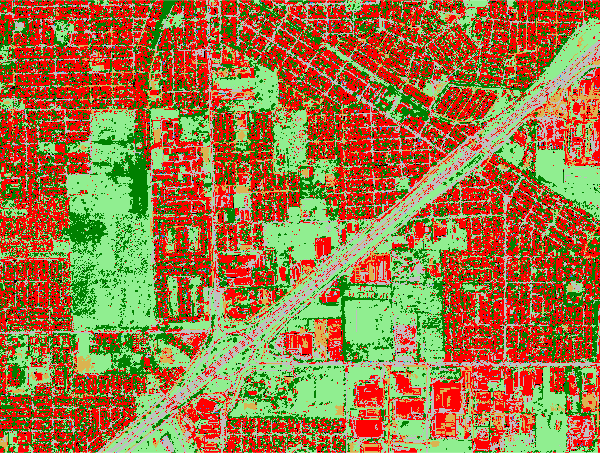

In [84]:
# Display results
obia = gj.Map(use_region=True)
obia.d_rast(map="classification_rf")
obia.show()

In [85]:
!cat var_imp.txt

Classifier: rf******************************                                  Overall
PNEO3_20221028_NDVI_res_mean   100.000000
PNEO3_20221028_NDWI_res_mean    76.073040
PNEO3_20221028_P_res2_mean      44.143473
PNEO3_20221028_NDWI_res_stddev  35.007671
PNEO3_20221028_NDVI_res_stddev  19.324017
compact_circle                  17.798900
compact_square                  16.389681
perimeter                       16.122469
PNEO3_20221028_P_res2_stddev    11.302438
area                            10.493293
PNEO3_20221028_text_IDM_mean     3.425473
PNEO3_20221028_text_IDM_stddev   3.019898
PNEO3_20221028_text_ASM_mean     2.880496
PNEO3_20221028_text_ASM_stddev   0.000000


In [86]:
!cat accuracy.csv

method,accuracy,kappa
rf,0.590421299876408,0.50596358897866


In [87]:
!cat classifier_runs.txt

BEST TUNING VALUES******************************$rf
  mtry
5    7



SUMMARY OF RESAMPLING RESULTS******************************

    Accuracy          Kappa          Resample        
 Min.   :0.4412   Min.   :0.3298   Length:50         
 1st Qu.:0.5294   1st Qu.:0.4391   Class :character  
 Median :0.5695   Median :0.4839   Mode  :character  
 Mean   :0.5904   Mean   :0.5060                     
 3rd Qu.:0.6526   3rd Qu.:0.5667                     
 Max.   :0.7568   Max.   :0.6995                     


RESAMPLED CONFUSION MATRICES******************************

$rf
Cross-Validated (5 fold, repeated 10 times) Confusion Matrix 

(entries are percentual average cell counts across resamples)
 
          Reference
Prediction class_1 class_2 class_3 class_4 class_5 class_6 class_7
   class_1    12.2     1.4     0.1     1.2     0.0     0.0     0.7
   class_2     0.4    10.9     0.0     1.2     0.4     1.8     0.2
   class_3     1.4     0.6     3.4     1.6     0.1     0.2     0.6
   class_4 

### 4.3.4. Validation with the test dataset (30%)

In [88]:
# Add column to test point map
gs.run_command("v.db.addcolumn",
               map="testing",
               column="pred_class integer")

In [89]:
# Query the classified map
gs.run_command("v.rast.stats",
               map="testing",
               column_prefix="pred_class",
               raster="classification_rf",
               method="median",
               flags="c") #this flag was added to update that column that already exists, otherwise do not use it.

In [90]:
gs.vector_db_select("testing")["columns"]

['cat',
 'area',
 'perimeter',
 'compact_circle',
 'compact_square',
 'PNEO3_20221028_text_ASM_mean',
 'PNEO3_20221028_text_ASM_stddev',
 'PNEO3_20221028_text_IDM_mean',
 'PNEO3_20221028_text_IDM_stddev',
 'PNEO3_20221028_NDVI_res_mean',
 'PNEO3_20221028_NDVI_res_stddev',
 'PNEO3_20221028_NDWI_res_mean',
 'PNEO3_20221028_NDWI_res_stddev',
 'PNEO3_20221028_P_res2_mean',
 'PNEO3_20221028_P_res2_stddev',
 'class',
 'pred_class',
 'pred_class_median']

In [91]:
# Convert labeled test segments to raster
gs.run_command("v.to.rast",
               input="testing",
               use="attr",
               attribute_column="class",
               output="testing")

In [92]:
# Create confusion matrix and estimate precision measures
print(gs.read_command("r.kappa",
                      classification="classification_rf",
                      reference="testing"))

			ACCURACY ASSESSMENT
LOCATION: CBAposgar2007				Tue Oct 10 15:04:34 2023
MASK: none
MAPS: MAP1 = Categories (testing in pleiades)
      MAP2 = Reclass of segments_full_region in pleiades (classification_rf in pleiades)

Error Matrix (MAP1: reference, MAP2: classification)
Panel #1 of 2
			  MAP1
     cat#	1	2	3	4	5	
 M     1	1961	5703	0	0	0	
 A     2	18516	142589	523	0	0	
 P     3	0	0	116	0	0	
 2     4	9	59	0	14722	795	
       5	0	0	0	0	74883	
       6	0	0	0	0	5977	
       7	0	0	0	0	0	
Col Sum		20486	148351	639	14722	81655	

Panel #2 of 2
			  MAP1
     cat#	6	7	Row Sum
 M     1	0	611	8275
 A     2	1822	0	163450
 P     3	0	0	116
 2     4	450	1603	17638
       5	24345	0	99228
       6	4579	0	10556
       7	0	0	0
Col Sum		31196	2214	299263


Cats	% Commission	% Omission	Estimated Kappa
1	76.302115	90.427609	0.180908
2	12.762924	3.884032	0.746907
3	0.000000	81.846635	1.000000
4	16.532487	0.000000	0.826121
5	24.534406	8.293430	0.662593
6	56.621826	85.321836	0.367889
7	NA		100.000000	NA



## 4.4. Download the classification as raster

In [93]:
#Download classification_rf as raster file
gs.run_command("r.out.gdal",
               input="classification_rf",
               output="classification_rf.tif")